# Notebook for article "Mapping the Unmapped: A Guide to Extracting Unofficial Roads & Tracks with ML-enhanced OSM Daylight"

Find the associated article [here](https://medium.com/@jen.wnzel/mapping-the-unmapped-a-guide-to-extracting-unofficial-roads-tracks-with-ml-enhanced-osm-daylight-b48bad0513a1)

## Set up tools

In [ ]:
# Install required command line tools. 
!brew install osmium-tool osmosis

In [ ]:
# Install Python packages into conda environment. 
%conda install -c conda-forge geopandas matplotlib pyrosm

In [2]:
# Import libraries. 
import geopandas as gpd
import matplotlib.pyplot as plt
import os 
from pyrosm import OSM

# Suppress warnings.
import warnings
warnings.filterwarnings('ignore')

## Get data

In [ ]:
# Set data download URLs and file names.
osm_daylight_url = 'https://daylight-map-distribution.s3.us-west-1.amazonaws.com/release/v1.30/planet-v1.30.osm.pbf'
# Get file name from URL 
osm_daylight_file = os.path.join('./data/input/', os.path.basename(osm_daylight_url))

# Note: pbf and bz2 files are just compressed osm files. 
fb_ml_roads_url = 'https://daylight-map-distribution.s3.us-west-1.amazonaws.com/release/v1.30/fb-ml-roads-v1.30.osc.bz2'
fb_ml_roads_file = os.path.join('./data/input/', os.path.basename(fb_ml_roads_url))

In [ ]:
# Download OSM daylight and FB ML roads data. 
!curl $osm_daylight_url -o $osm_daylight_file
!curl $fb_ml_roads_url -o $fb_ml_roads_file 

## Process data

In [ ]:
complete_osm_file = './data/input/complete_osm.osm.pbf'

# Create combined PBF file from complete current daylight dataset and Facebook Experimental ML Roads addition. 
!osmium apply-changes {osm_daylight_file} {fb_ml_roads_file} -o {complete_osm_file}

### Set AOI

In [4]:
# Get local AOI shapefile as geodataframe and in geographic CRS EPSG:4326.
aoi_file = './data/input/aoi_4326.zip'
aoi_gdf = gpd.read_file(aoi_file, crs='epsg:4326') 
aoi_gdf.head()

,Id,Size,TFCA,Country,Name,geometry
0,0,19319.391915,KAZA,Zambia,Sioma Nqwezi Management Complex,"POLYGON ((23.26915 -16.36248, 23.27304 -16.362..."


In [16]:
# Define function to get bounding box of AOI.
def get_bbox(shp):
    bbox = shp.bounds.values[0]
    bbox_str = ','.join([str(round(x,6)) for x in bbox])
    return bbox_str

In [18]:
# Get bounding box of AOI.
aoi_bbox = get_bbox(aoi_gdf)
aoi_bbox

'22.058816,-17.64505,24.258215,-16.293109'

### Extract relevant features

In [21]:
# Filter to Sioma area from complete PBF file. 
aoi_osm_file = './data/output/sioma_osm.osm.pbf'
!osmium extract -b {aoi_bbox} {complete_osm_file} -o {aoi_osm_file}

[======================================================================] 100% 


In [24]:
# Extract roads from complete area data. 
aoi_roads_file = './data/output/sioma_roads.osm.pbf'
!osmosis --read-pbf  {aoi_osm_file} --tf accept-ways 'highway=*' --used-node --write-pbf {aoi_roads_file}

Oct 05, 2023 4:42:21 PM org.openstreetmap.osmosis.core.Osmosis run
INFO: Osmosis Version 0.48.3
Oct 05, 2023 4:42:21 PM org.openstreetmap.osmosis.core.Osmosis run
INFO: Preparing pipeline.
Oct 05, 2023 4:42:21 PM org.openstreetmap.osmosis.core.Osmosis run
INFO: Launching pipeline execution.
Oct 05, 2023 4:42:21 PM org.openstreetmap.osmosis.core.Osmosis run
INFO: Pipeline executing, waiting for completion.
Oct 05, 2023 4:42:25 PM org.openstreetmap.osmosis.core.Osmosis run
INFO: Pipeline complete.
Oct 05, 2023 4:42:25 PM org.openstreetmap.osmosis.core.Osmosis run
INFO: Total execution time: 4362 milliseconds.


### Create connected road network

In [72]:
# Get OSM streets data.
# when run from here, if AOI roads file already exists
#aoi_roads_file = './data/output/sioma_roads.osm.pbf'
osm = OSM(aoi_roads_file)

In [75]:
# Get fully connected network for all road types and clip with AOI.
complete_network = osm.get_network(network_type='all').clip(aoi_gdf)

In [80]:
complete_network.head()

,bicycle,bridge,foot,highway,junction,lanes,maxspeed,name,oneway,ref,smoothness,surface,tracktype,id,timestamp,version,tags,osm_type,geometry,length
12254,None,None,None,track,None,None,None,None,None,None,None,unpaved,None,1219346830,1691193600,1,"{""lint_disconnected"":""true"",""source"":""ML2FB"",""...",way,"MULTILINESTRING ((24.03745 -17.51272, 24.03644...",394.0
33918,None,None,None,track,None,None,None,None,None,None,None,unpaved,None,1231561179,1691193600,1,"{""lint_disconnected"":""true"",""source"":""ML2FB"",""...",way,"MULTILINESTRING ((24.06316 -17.50875, 24.06299...",717.0
24491,None,None,None,track,None,None,None,None,None,None,None,unpaved,None,1226239124,1691193600,1,"{""lint_disconnected"":""true"",""source"":""ML2FB"",""...",way,"MULTILINESTRING ((24.06426 -17.50859, 24.06401...",426.0
27901,None,None,None,track,None,None,None,None,None,None,None,unpaved,None,1228167157,1691193600,1,"{""lint_disconnected"":""true"",""source"":""ML2FB"",""...",way,"MULTILINESTRING ((24.05168 -17.50626, 24.05194...",218.0
15334,None,None,None,track,None,None,None,None,None,None,None,unpaved,None,1221122560,1691193600,1,"{""lint_disconnected"":""true"",""source"":""ML2FB"",""...",way,"MULTILINESTRING ((24.04200 -17.50453, 24.04163...",518.0


In [76]:
# Select and rename features of interest.
selected_features = {'way_id': complete_network['id'], 'type': complete_network['highway'], 'name': complete_network['ref'], 'geometry': complete_network['geometry'], 'length': complete_network['length'],'surface': complete_network['surface']}
# Create geodataframe from selected features.
roads_gdf = gpd.GeoDataFrame(selected_features, crs='epsg:4326')

## Analyze data

In [123]:
roads_gdf.head()

,way_id,type,name,geometry,length,surface
12254,1219346830,track,None,"MULTILINESTRING ((24.03745 -17.51272, 24.03644...",394.0,unpaved
33918,1231561179,track,None,"MULTILINESTRING ((24.06316 -17.50875, 24.06299...",717.0,unpaved
24491,1226239124,track,None,"MULTILINESTRING ((24.06426 -17.50859, 24.06401...",426.0,unpaved
27901,1228167157,track,None,"MULTILINESTRING ((24.05168 -17.50626, 24.05194...",218.0,unpaved
15334,1221122560,track,None,"MULTILINESTRING ((24.04200 -17.50453, 24.04163...",518.0,unpaved


In [124]:
print(f'Total number of road sections: {len(roads_gdf)}')
print(f'Total length of all roads in network: {complete_network["length"].sum()}')
print(f'All road type classes: {roads_gdf["type"].unique()}')
print(f'All named roads: {roads_gdf["name"].unique()}')

Total number of road sections: 25230
Total length of all roads in network: 18515788.0
All road type classes: ['track' 'residential' 'trunk' 'path' 'primary' 'unclassified' 'tertiary'
 'service' 'secondary' 'footway' 'yes']
All named roads: [None 'M10' 'RD324' 'RD323' 'RD325' 'RD462' 'RD322' 'RD 463']


In [119]:
from IPython.display import display, HTML

''' Define function to get table of total road lengths by a certain feature like surface type.
    Akin to a frequency table, however in this case length is more indicative of the size than the frequency, 
    since a road can be split in pieces with various lengths.
'''
def get_length_stats(feature:str, network:gpd.GeoDataFrame) -> gpd.GeoDataFrame:
    return network.groupby([feature])[['length']].sum().sort_values(by='length', ascending=False)

# Create html tables from result tables for different features.
size_by_surface = get_length_stats('surface', complete_network).to_html()
size_by_type = get_length_stats('highway', complete_network).to_html()

# Define HTML code to display tables side by side.
html = f"<div style='display: inline-block; margin-right: 10px;'>{size_by_surface}</div><div style='display: inline-block;'>{size_by_type}</div>"

# Display the HTML containing the tables.
display(HTML(html))

,length
surface,
unpaved,13818051.0
sand,689517.0
asphalt,197033.0
dirt,104951.0
ground,85360.0
gravel,504.0
,length
highway,
track,14818905.0


## Visualize data

### Assign colors to roads by type

In [61]:
# Set road type colors.
type_colors = {
    "footway": "orange",
    "path": "darkkhaki",
    "primary": "yellow",
    "residential": "red",
    "secondary": "green",
    "service": "blue",
    "tertiary": "black",
    "track": "peru",
    "trunk": "cyan",
    "unclassified": "darkgray",
    "yes": "saddlebrown",
    "trunk_link": "lightgray"
}

In [35]:
# Define function to assign colors to roads for subsequent visualisation.
def assign_colors2roads(roads_gdf):
    for index, road in roads_gdf.iterrows():
        if road['type'] in type_colors:
            road['color'] = type_colors[road['type']]
            roads_gdf.loc[index, 'color'] = road['color']
    return roads_gdf


In [36]:
# Apply color assignment function.
colored_gdf = assign_colors2roads(roads_gdf)
colored_gdf.head()

,way_id,type,name,geometry,length,surface,color
12254,1219346830,track,None,"MULTILINESTRING ((24.03745 -17.51272, 24.03644...",394.0,unpaved,peru
33918,1231561179,track,None,"MULTILINESTRING ((24.06316 -17.50875, 24.06299...",717.0,unpaved,peru
24491,1226239124,track,None,"MULTILINESTRING ((24.06426 -17.50859, 24.06401...",426.0,unpaved,peru
27901,1228167157,track,None,"MULTILINESTRING ((24.05168 -17.50626, 24.05194...",218.0,unpaved,peru
15334,1221122560,track,None,"MULTILINESTRING ((24.04200 -17.50453, 24.04163...",518.0,unpaved,peru


### Plot roads by type

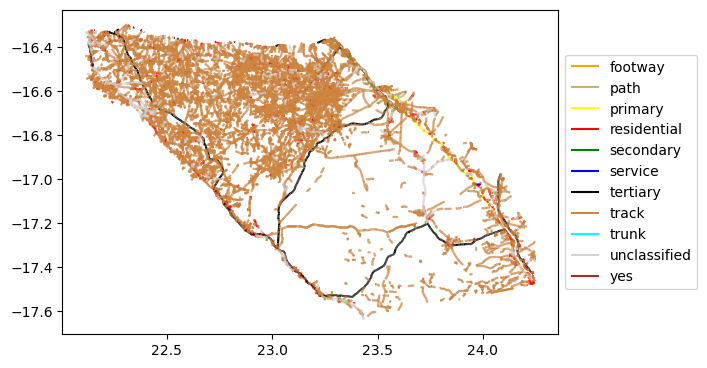

In [37]:
fig, ax = plt.subplots()
grouped = colored_gdf.groupby('type')
for key, group in grouped:
    group.plot(ax=ax, color=group['color'], label=key)
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

In [66]:
import matplotlib.colors as colors
import xyzservices
# Create a TileProvider object for Google Maps.
gmap_tiles = xyzservices.TileProvider(url='https://mt1.google.com/vt/lyrs=s&x={x}&y={y}&z={z}', name='Google Maps Satellite', attribution='Google')
colored_gdf.explore(column='type', cmap=colors.ListedColormap(list(type_colors.values())), legend=True, tiles=gmap_tiles)

## Export data

In [43]:
# Check available drivers determining which file types the network can be exported as. 
from fiona.drvsupport import supported_drivers
print(supported_drivers)

{'DXF': 'rw', 'CSV': 'raw', 'OpenFileGDB': 'raw', 'ESRIJSON': 'r', 'ESRI Shapefile': 'raw', 'FlatGeobuf': 'raw', 'GeoJSON': 'raw', 'GeoJSONSeq': 'raw', 'GPKG': 'raw', 'GML': 'rw', 'OGR_GMT': 'rw', 'GPX': 'rw', 'MapInfo File': 'raw', 'DGN': 'raw', 'S57': 'r', 'SQLite': 'raw', 'TopoJSON': 'r'}


In [44]:
# Export roads network to shapefile.
roads_shp_file = './data/output/sioma_roads.shp'
roads_gdf.to_file(roads_shp_file, driver='ESRI Shapefile')